In [2]:
import os
os.chdir('/content')
CODE_DIR = 'encoder4editing'

!git clone https://github.com/omertov/encoder4editing.git $CODE_DIR
!sudo apt-get update -qq
!sudo apt-get install -y ninja-build

os.chdir(f'./{CODE_DIR}')

from argparse import Namespace
import time
import os
import sys
import numpy as np
from PIL import Image
import torch
import torchvision.transforms as transforms

sys.path.append(".")
sys.path.append("..")

from utils.common import tensor2im
from models.psp import pSp  # load e4e encoder

# optional fix for autoreload
import sys, types, importlib
sys.modules['imp'] = types.SimpleNamespace(reload=importlib.reload)
%load_ext autoreload
%autoreload 2


fatal: destination path 'encoder4editing' already exists and is not an empty directory.
W: Skipping acquire of configured file 'main/source/Sources' as repository 'https://r2u.stat.illinois.edu/ubuntu jammy InRelease' does not seem to provide it (sources.list entry misspelt?)
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  ninja-build
0 upgraded, 1 newly installed, 0 to remove and 46 not upgraded.
Need to get 111 kB of archives.
After this operation, 358 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 ninja-build amd64 1.10.1-1 [111 kB]
Fetched 111 kB in 1s (128 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 78, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable 

In [4]:
!pip install PyDrive gdown oauth2client --quiet

from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

download_with_pydrive = True  # or False if you just want gdown

class Downloader(object):
    def __init__(self, use_pydrive):
        self.use_pydrive = use_pydrive
        current_directory = os.getcwd()
        self.save_dir = os.path.join(os.path.dirname(current_directory), CODE_DIR, "pretrained_models")
        os.makedirs(self.save_dir, exist_ok=True)
        if self.use_pydrive:
            self.authenticate()

    def authenticate(self):
        auth.authenticate_user()
        gauth = GoogleAuth()
        gauth.credentials = GoogleCredentials.get_application_default()
        self.drive = GoogleDrive(gauth)

    def download_file(self, file_id, file_name):
        file_dst = f'{self.save_dir}/{file_name}'
        if os.path.exists(file_dst):
            print(f'{file_name} already exists!')
            return
        if self.use_pydrive:
            downloaded = self.drive.CreateFile({'id':file_id})
            downloaded.FetchMetadata(fetch_all=True)
            downloaded.GetContentFile(file_dst)
        else:
            !gdown --id $file_id -O $file_dst

downloader = Downloader(download_with_pydrive)


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 987.4/987.4 kB 35.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


## Step 1: Select Experiment Type
Select which experiment you wish to perform inference on:
1. ffhq_encode
2. cars_encode
3. horse_encode
4. church_encode

In [5]:
experiment_type = 'ffhq_encode' #@param ['ffhq_encode', 'cars_encode', 'horse_encode', 'church_encode']

## Step 2: Download Pretrained Models
As part of this repository, we provide pretrained models for each of the above experiments. We'll download the model for the selected experiments and save it to the folder `pretrained_models`.

In [7]:
!pip install gdown --quiet

import os
os.makedirs("pretrained_models", exist_ok=True)

file_id = MODEL_PATHS["ffhq_encode"]["id"]  # or whichever you set as experiment_type
file_name = MODEL_PATHS["ffhq_encode"]["name"]
!gdown --id {file_id} -O pretrained_models/{file_name}


/usr/local/lib/python3.12/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1cUv_reLE6k3604or78EranS7XzuVMWeO
From (redirected): https://drive.google.com/uc?id=1cUv_reLE6k3604or78EranS7XzuVMWeO&confirm=t&uuid=687040b6-62f6-4d4e-b1ea-2fbc309f8022
To: /content/encoder4editing/pretrained_models/e4e_ffhq_encode.pt
100% 1.20G/1.20G [00:27<00:00, 43.4MB/s]


## Step 3: Define Inference Parameters

All e4e modls wit h e4e image libraries

In [8]:
EXPERIMENT_DATA_ARGS = {
    "ffhq_encode": {
        "model_path": "pretrained_models/e4e_ffhq_encode.pt",
        "image_path": "notebooks/images/input_img.jpg"
    },
    "cars_encode": {
        "model_path": "pretrained_models/e4e_cars_encode.pt",
        "image_path": "notebooks/images/car_img.jpg"
    },
    "horse_encode": {
        "model_path": "pretrained_models/e4e_horse_encode.pt",
        "image_path": "notebooks/images/horse_img.jpg"
    },
    "church_encode": {
        "model_path": "pretrained_models/e4e_church_encode.pt",
        "image_path": "notebooks/images/church_img.jpg"
    }

}
# Setup required image transformations
EXPERIMENT_ARGS = EXPERIMENT_DATA_ARGS[experiment_type]
if experiment_type == 'cars_encode':
    EXPERIMENT_ARGS['transform'] = transforms.Compose([
            transforms.Resize((192, 256)),
            transforms.ToTensor(),
            transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])])
    resize_dims = (256, 192)
else:
    EXPERIMENT_ARGS['transform'] = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])])
    resize_dims = (256, 256)

##  Load Model - pretrained

In [9]:
model_path = EXPERIMENT_ARGS['model_path']
ckpt = torch.load(model_path, map_location='cpu')
opts = ckpt['opts']
# pprint.pprint(opts)  # Display full options used
# update the training options
opts['checkpoint_path'] = model_path
opts= Namespace(**opts)
net = pSp(opts)
net.eval()
net.cuda()
print('Model successfully loaded!')

Loading e4e over the pSp framework from checkpoint: pretrained_models/e4e_ffhq_encode.pt
Model successfully loaded!


## checking if image came

In [10]:
image_path = EXPERIMENT_DATA_ARGS[experiment_type]["image_path"]
original_image = Image.open(image_path)
original_image = original_image.convert("RGB")

### Image Alignment
For the FFHQ StyleGAN inversion, we first align the image

--2025-11-10 13:16:38--  http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
Resolving dlib.net (dlib.net)... 107.180.26.78
Connecting to dlib.net (dlib.net)|107.180.26.78|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2 [following]
--2025-11-10 13:16:39--  https://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
Connecting to dlib.net (dlib.net)|107.180.26.78|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 64040097 (61M)
Saving to: ‘shape_predictor_68_face_landmarks.dat.bz2’

shape_predictor_68_ 100%[===================>]  61.07M  12.7MB/s    in 5.7s    

2025-11-10 13:16:45 (10.6 MB/s) - ‘shape_predictor_68_face_landmarks.dat.bz2’ saved [64040097/64040097]

Aligned image has shape: (256, 256)


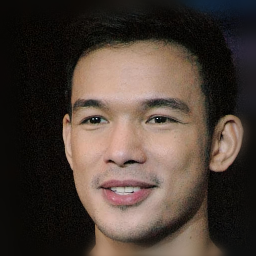

In [11]:
if experiment_type == "ffhq_encode" and 'shape_predictor_68_face_landmarks.dat' not in os.listdir():
    !wget http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
    !bzip2 -dk shape_predictor_68_face_landmarks.dat.bz2

def run_alignment(image_path):
  import dlib
  from utils.alignment import align_face
  predictor = dlib.shape_predictor("shape_predictor_68_face_landmarks.dat")
  aligned_image = align_face(filepath=image_path, predictor=predictor)
  print("Aligned image has shape: {}".format(aligned_image.size))
  return aligned_image

if experiment_type == "ffhq_encode":
  input_image = run_alignment(image_path)
else:
  input_image = original_image

input_image.resize(resize_dims)

## Inferenceeee

In [12]:
img_transforms = EXPERIMENT_ARGS['transform']
transformed_image = img_transforms(input_image)

In [13]:
def display_alongside_source_image(result_image, source_image):
    res = np.concatenate([np.array(source_image.resize(resize_dims)),
                          np.array(result_image.resize(resize_dims))], axis=1)
    return Image.fromarray(res)

def run_on_batch(inputs, net):
    images, latents = net(inputs.to("cuda").float(), randomize_noise=False, return_latents=True)
    if experiment_type == 'cars_encode':
        images = images[:, :, 32:224, :]
    return images, latents

Inference took 1.9895 seconds.


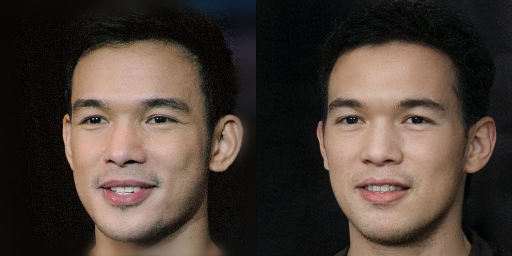

In [14]:
with torch.no_grad():
    tic = time.time()
    images, latents = run_on_batch(transformed_image.unsqueeze(0), net)
    result_image, latent = images[0], latents[0]
    toc = time.time()
    print('Inference took {:.4f} seconds.'.format(toc - tic))

# Display inversion:
display_alongside_source_image(tensor2im(result_image), input_image)

## Edit

In [17]:
from editings import latent_editor
is_cars = experiment_type == 'cars_encode'
editor = latent_editor.LatentEditor(net.decoder, is_cars)

In [15]:
# InterFaceGAN
interfacegan_directions = {
    'ffhq_encode': {
        'age': 'editings/interfacegan_directions/age.pt',
        'smile': 'editings/interfacegan_directions/smile.pt',
        'pose': 'editings/interfacegan_directions/pose.pt'
    }
}
available_interfacegan_directions = None
if experiment_type in interfacegan_directions:  # List supported directions for the current experiment
    available_interfacegan_directions = interfacegan_directions[experiment_type]
    print(list(available_interfacegan_directions.keys()))

['age', 'smile', 'pose']


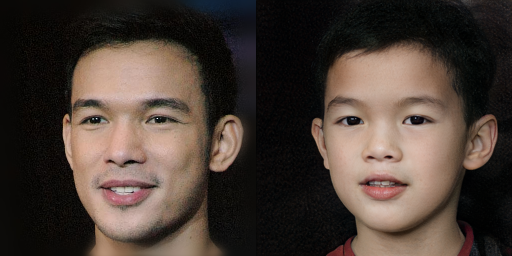

In [18]:
# As an example, we currently released the age and smile directions for the FFHQ StyleGAN Generator.
interfacegan_direction = torch.load(available_interfacegan_directions["age"]).cuda()

# For a single edit:
result = editor.apply_interfacegan(latents, interfacegan_direction, factor=-3).resize(resize_dims)
display_alongside_source_image(result, input_image)

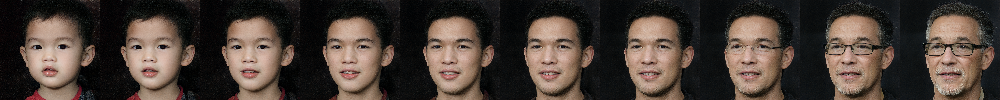

In [ ]:
# Or, apply a range of editings
editor.apply_interfacegan(latents, interfacegan_direction, factor_range=(-5, 5))

In [29]:
# Typical SEFA edit pattern (for StyleGAN2)
edited_latents = sefa.edit(G=editor.generator,
                           latents=latent.unsqueeze(0),
                           layer_idx=[0,1,2,3,4,5,6,7],
                           start_distance=-5.0,
                           end_distance=5.0,
                           steps=7)


NameError: name 'sefa' is not defined

**Style gan age direction**

/content/encoder4editing/stylegan2-ada-pytorch/stylegan2-ada-pytorch/stylegan2-ada-pytorch
✅ GPU available: True

Loading pretrained FFHQ generator (StyleGAN2-ADA)...
✅ Model loaded successfully!


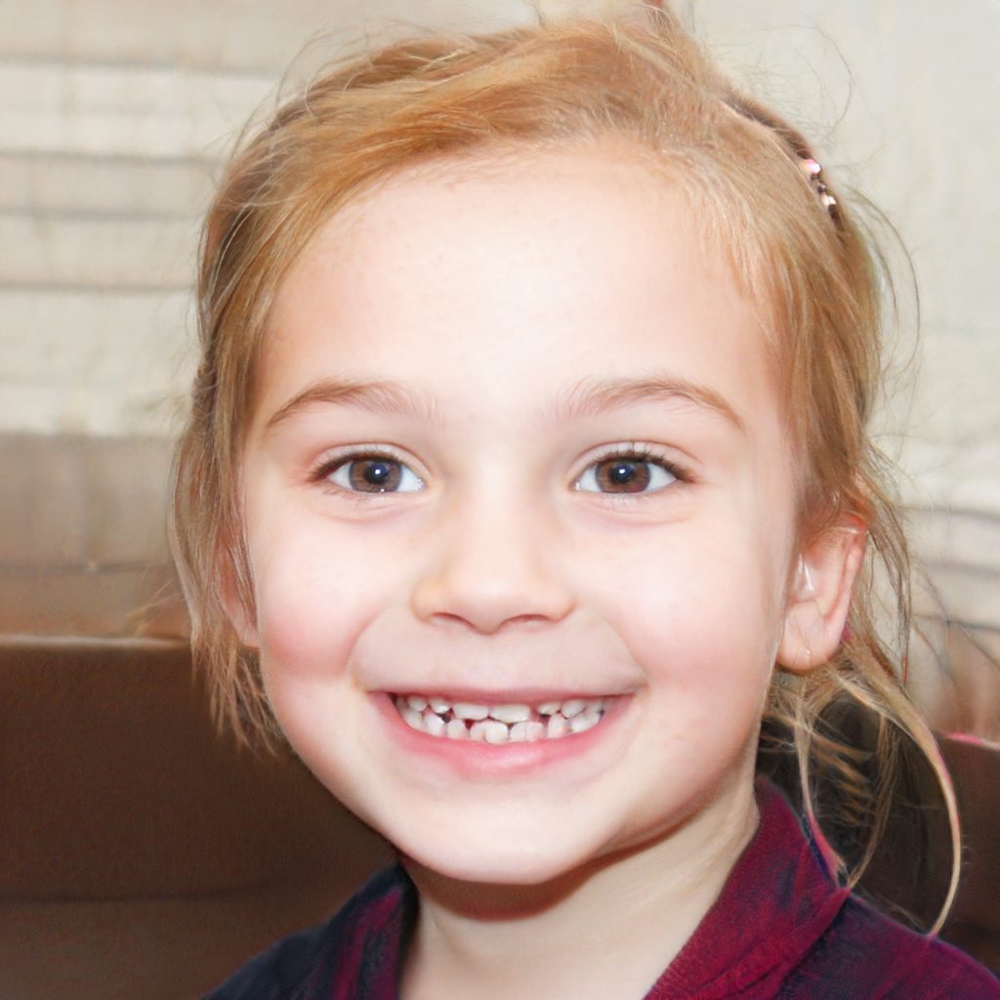

In [39]:
# ==========================================================
# ✅ STYLEGAN2-ADA — Full Setup and Random Face Generation (Fixed Display)
# ==========================================================

# --- Step 1: Clone and set up the StyleGAN2-ADA repo ---
!git clone -q https://github.com/NVlabs/stylegan2-ada-pytorch.git
%cd stylegan2-ada-pytorch

# --- Step 2: Imports and device setup ---
import torch, dnnlib, legacy
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import display, Image
import PIL.Image

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print("✅ GPU available:", torch.cuda.is_available())

# --- Step 3: Load pretrained StyleGAN2-ADA FFHQ model ---
network_pkl = "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"

print("\nLoading pretrained FFHQ generator (StyleGAN2-ADA)...")
with dnnlib.util.open_url(network_pkl) as f:
    G = legacy.load_network_pkl(f)['G_ema'].to(device)
print("✅ Model loaded successfully!")

# --- Step 4: Generate a random latent and synthesize image ---
z = torch.randn(1, G.z_dim, device=device)   # latent in Z space
w = G.mapping(z, None)                       # map to W space
img = G.synthesis(w, noise_mode='const')     # generate image

# --- Step 5: Convert to numpy and save/display properly ---
img = (img.clamp(-1, 1) + 1) * 127.5         # [-1,1] → [0,255]
img = img[0].permute(1, 2, 0).detach().cpu().numpy().astype(np.uint8)
PIL.Image.fromarray(img).save("/content/result.png")

# Show inline
display(Image("/content/result.png"))


Your encoded latent shape: torch.Size([18, 512])
Prepared latent shape for StyleGAN synthesis: torch.Size([1, 18, 512])


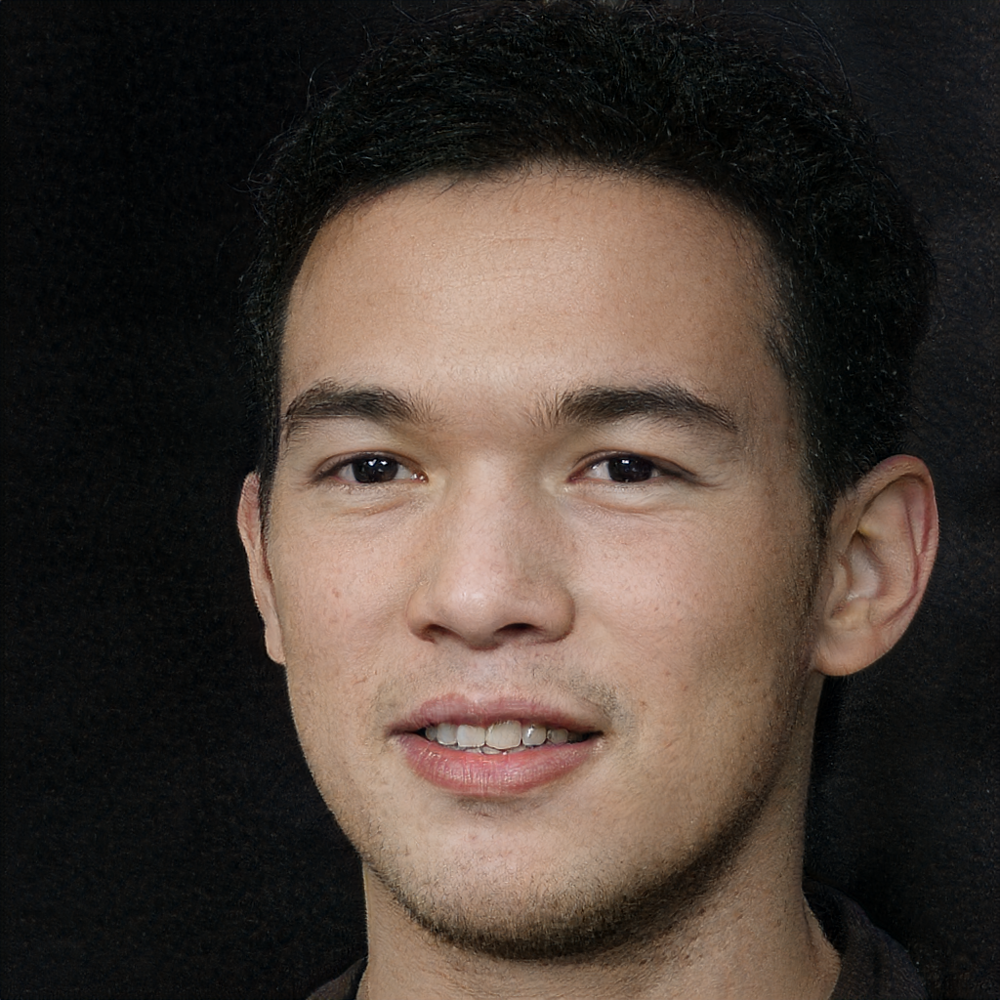

✅ Original image generated from your encoded latent.


In [40]:
# ==========================================================
# ✅ STEP 2: Use your encoded latent vector (from e4e) and apply SeFa
# ==========================================================

import numpy as np
import torch

# Suppose 'latent' is your encoded latent from e4e (shape [18,512])
# If it's not already in memory, load it here:
# latent = torch.load('/path/to/your_latent.pt')

print("Your encoded latent shape:", latent.shape)

# Move to device and reshape for StyleGAN
w = latent.unsqueeze(0).to(device)  # shape [1,18,512]
print("Prepared latent shape for StyleGAN synthesis:", w.shape)

# Generate the unedited image first
img = G.synthesis(w, noise_mode='const')
img = (img.clamp(-1, 1) + 1) * 127.5
img = img[0].permute(1, 2, 0).detach().cpu().numpy().astype(np.uint8)

from IPython.display import display, Image
import PIL.Image

PIL.Image.fromarray(img).save("/content/original_latent.png")
display(Image("/content/original_latent.png"))
print("✅ Original image generated from your encoded latent.")


Cloning into 'stylegan2-ada-pytorch'...
remote: Enumerating objects: 131, done.
remote: Counting objects: 100% (2/2), done.
remote: Compressing objects: 100% (2/2), done.
remote: Total 131 (delta 0), reused 0 (delta 0), pack-reused 129 (from 2)
Receiving objects: 100% (131/131), 1.13 MiB | 27.56 MiB/s, done.
Resolving deltas: 100% (57/57), done.
/content/encoder4editing/stylegan2-ada-pytorch/stylegan2-ada-pytorch/stylegan2-ada-pytorch/stylegan2-ada-pytorch/stylegan2-ada-pytorch/stylegan2-ada-pytorch
✅ GPU available: True
⏳ Loading pretrained FFHQ generator...
✅ Model loaded successfully!


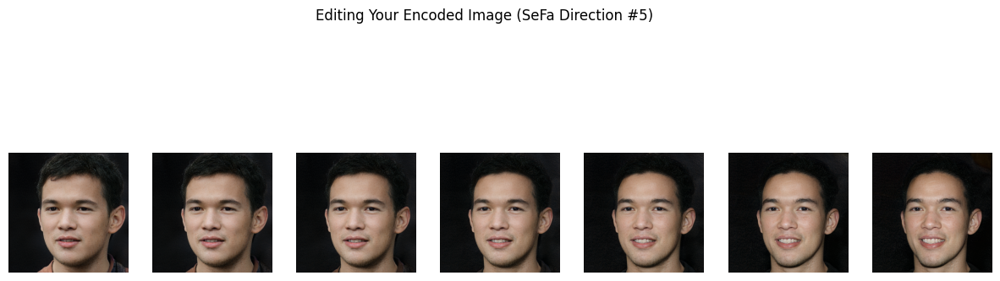

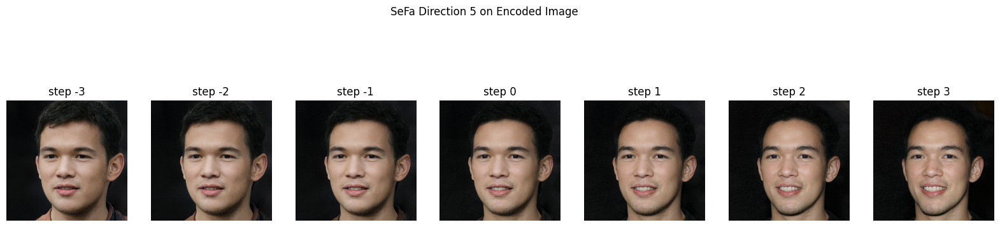

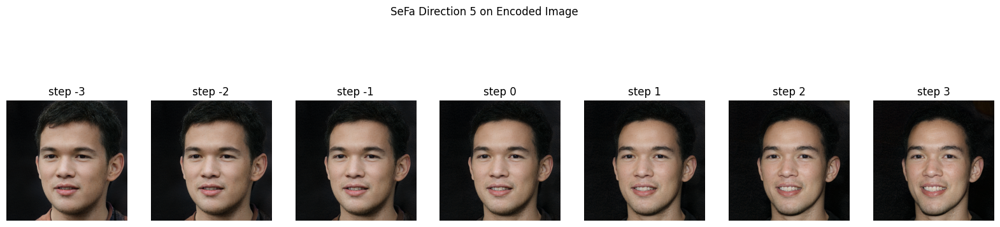

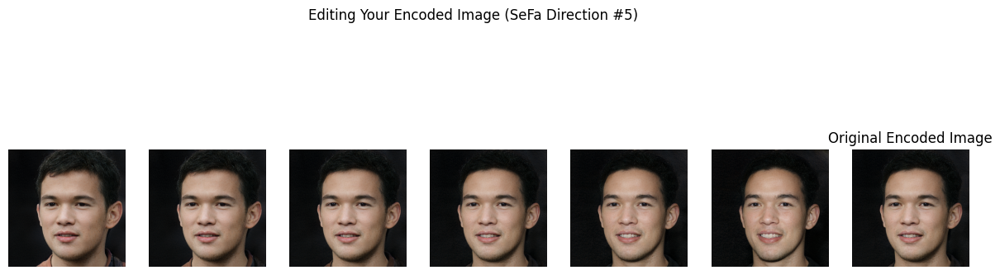

/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


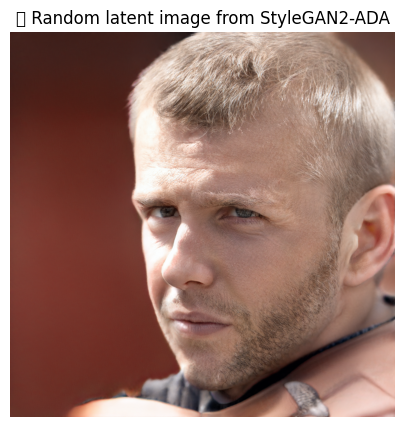

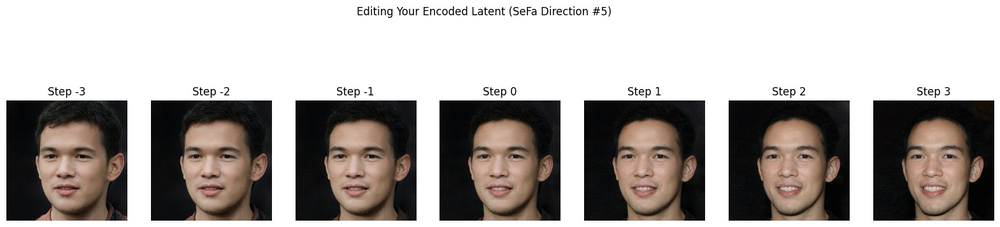

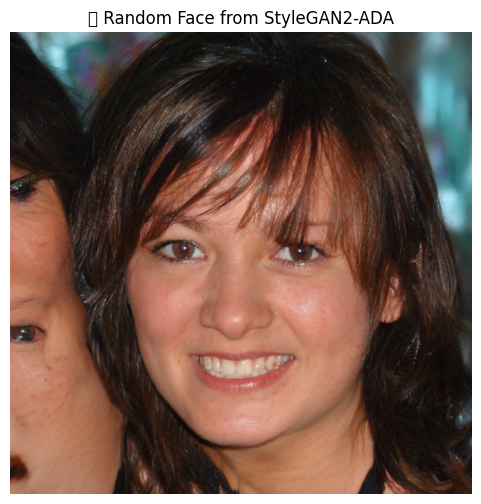

/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128118 (\N{BABY}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


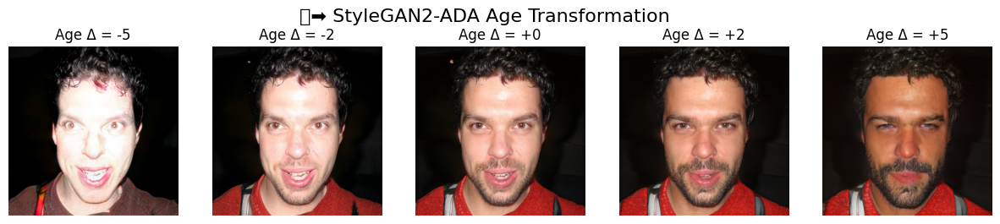

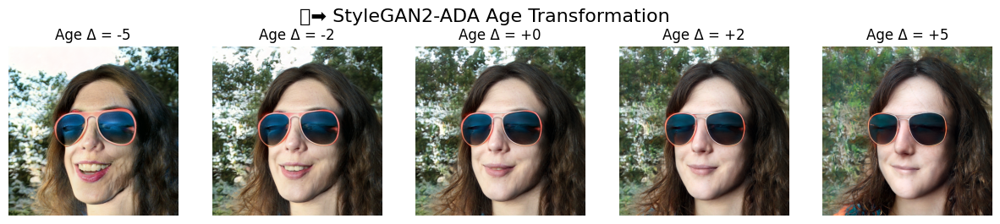

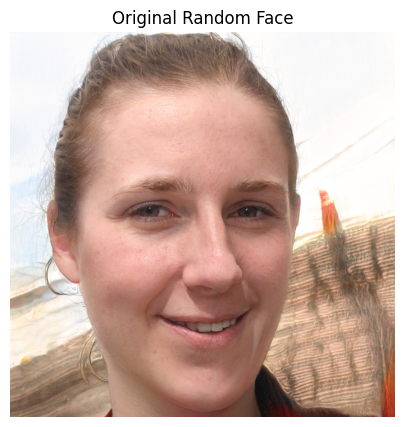

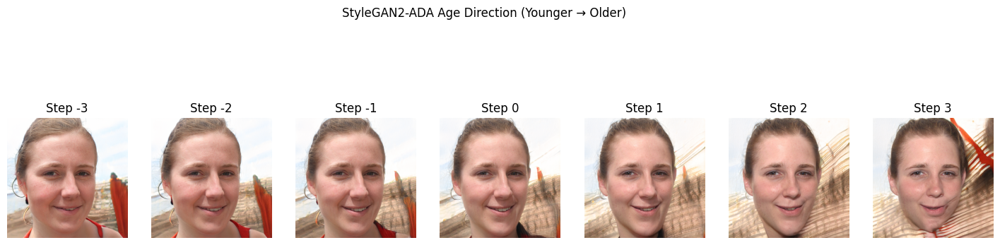

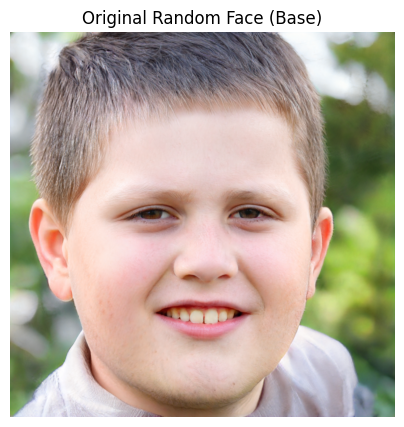

✅ Derived SeFa directions: torch.Size([512, 512])


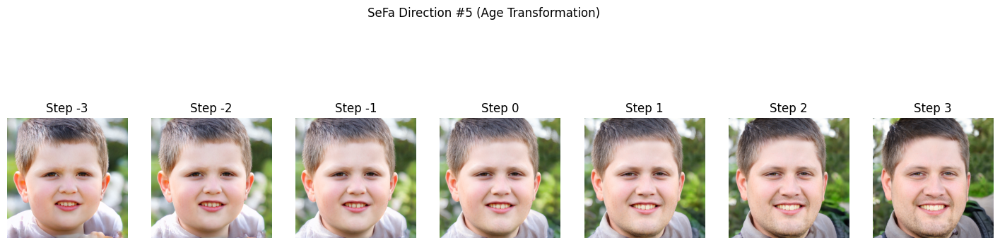

In [46]:
# ==========================================================
# 🧠 STYLEGAN2-ADA — Full Working Face + Age Editing Setup
# ==========================================================

# --- Step 1: Fresh setup ---
!rm -rf stylegan2-ada-pytorch
!git clone https://github.com/NVlabs/stylegan2-ada-pytorch.git
%cd stylegan2-ada-pytorch

# --- Step 2: Imports ---
import torch, numpy as np, matplotlib
import matplotlib.pyplot as plt
import dnnlib, legacy

# Force inline backend (Colab sometimes loses it)
%matplotlib inline
matplotlib.rcParams['figure.dpi'] = 100

# --- Step 3: Device setup ---
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print("✅ GPU available:", torch.cuda.is_available())

# --- Step 4: Load pretrained FFHQ model ---
network_pkl = "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"
print("⏳ Loading pretrained FFHQ generator...")
with dnnlib.util.open_url(network_pkl) as f:
    G = legacy.load_network_pkl(f)['G_ema'].to(device)
print("✅ Model loaded successfully!")

# --- Step 5: Generate base face ---
z = torch.randn(1, G.z_dim, device=device)
w = G.mapping(z, None)
img = G.synthesis(w, noise_mode='const')
img = (img.clamp(-1, 1) + 1) / 2

plt.figure(figsize=(5,5))
plt.imshow(np.clip(img[0].permute(1,2,0).detach().cpu().numpy(), 0, 1))
plt.axis('off')
plt.title("Original Random Face (Base)")
plt.show()

# --- Step 6: Compute SeFa directions ---
weights = []
for name, param in G.named_parameters():
    if 'affine' in name and 'weight' in name:
        weights.append(param.cpu().detach().numpy())
W = np.concatenate(weights, axis=0)
_, _, vh = np.linalg.svd(W, full_matrices=False)
directions = torch.from_numpy(vh).to(device)
print("✅ Derived SeFa directions:", directions.shape)

# --- Step 7: Apply SeFa age-like direction ---
age_dir = directions[5].unsqueeze(0).unsqueeze(0)
steps = [-3, -2, -1, 0, 1, 2, 3]
imgs = []
for step in steps:
    w_step = w + step * age_dir
    img = G.synthesis(w_step, noise_mode='const')
    imgs.append((img.clamp(-1,1)+1)/2)

# --- Step 8: Display young→old progression ---
fig, axs = plt.subplots(1, len(imgs), figsize=(18,5))
for i, img in enumerate(imgs):
    axs[i].imshow(np.clip(img[0].permute(1,2,0).detach().cpu().numpy(), 0, 1))
    axs[i].axis('off')
    axs[i].set_title(f"Step {steps[i]}")
plt.suptitle("SeFa Direction #5 (Age Transformation)")
plt.show()


Encoded latent shape: torch.Size([1, 18, 512])
✅ Found SeFa directions: torch.Size([512, 512])


/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 129491 (\N{OLDER ADULT}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


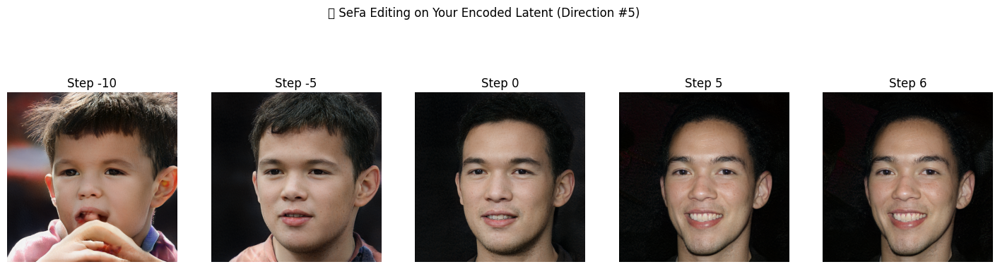

In [53]:
# ==========================================================
# ✅ Apply SeFa editing to YOUR encoded latent vector
# ==========================================================

import torch
import numpy as np
import matplotlib.pyplot as plt

# 1️⃣ Move your encoded latent to GPU and reshape
w = latent.unsqueeze(0).to(device)  # [1, 18, 512]
print("Encoded latent shape:", w.shape)

# 2️⃣ Compute SeFa directions (if not already done)
weights = []
for name, param in G.named_parameters():
    if 'affine' in name and 'weight' in name:
        weights.append(param.cpu().detach().numpy())

W = np.concatenate(weights, axis=0)
_, _, vh = np.linalg.svd(W, full_matrices=False)
directions = torch.from_numpy(vh).to(device)
print("✅ Found SeFa directions:", directions.shape)

# 3️⃣ Pick a direction (try #4, #5, or #7 for aging)
age_dir = directions[5].unsqueeze(0).unsqueeze(0)

# 4️⃣ Apply strong edits
steps = [-10, -5, 0, 5, 6]  # larger range = more visible change
imgs = []

for step in steps:
    w_step = w + step * age_dir
    img = G.synthesis(w_step, noise_mode='const')
    imgs.append((img.clamp(-1, 1) + 1) / 2)

# 5️⃣ Display results
fig, axs = plt.subplots(1, len(imgs), figsize=(18, 5))
for i, img in enumerate(imgs):
    axs[i].imshow(np.clip(img[0].permute(1, 2, 0).detach().cpu().numpy(), 0, 1))
    axs[i].axis('off')
    axs[i].set_title(f"Step {steps[i]}")
plt.suptitle("🧓 SeFa Editing on Your Encoded Latent (Direction #5)")
plt.show()
